In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [14]:
import argparse
import copy
import csv
import decimal
import typing
from collections import Counter
from dataclasses import dataclass
from pathlib import Path
from typing import Dict, List, Set, Tuple

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import simdjson as json
import skimage.io as io
from geo_llm_ret.fpref.ref_datasets import build_refcoco
from IPython.display import display
from pycocotools.coco import COCO
from pycocotools.helpers import CocoClassDistHelper

In [162]:
IMG_DIR = Path("/shared/gbiamby/data/coco/train2014")
REFSEG_DIR = Path("/shared/gbiamby/data/refer_seg")
dataset_name = "fprefcocog_v002"
split_by = "berkeley_exclude_unified"
refcoco = build_refcoco(REFSEG_DIR, dataset_name, split_by)
robustref = build_refcoco(REFSEG_DIR, "R-refcoco", "unc")

Loading refs from '/shared/gbiamby/data/refer_seg/fprefcocog_v002/refs(berkeley_exclude_unified).p'
Loaded 49822 refs
loading annotations into memory...
Done (t=3.76s)
creating index...
index created!
Loading refs from '/shared/gbiamby/data/refer_seg/R-refcoco/refs(unc).p'
Loaded 50000 refs
loading annotations into memory...
Done (t=9.29s)
creating index...
index created!


## Build Ref Stats DataFrame

In [38]:
def show_sentence_counts(coco: COCO, L=3, visualize=True):
    # print("Sentence counts for ", coco.)
    sentence_counts = Counter()
    counts = []
    anns_all = []
    for idx, ref in enumerate(coco.refs_data):
        sentences: list[dict] = ref["sentences"]
        count = len(sentences)
        sentence_counts.update({count: 1})
        counts.append(
            {
                "ref_id": ref["ref_id"],
                "image_id": ref["image_id"],
                "split": ref["split"] if "split" in ref else "",
                "ann_id": ref["ann_id"],
                "category_id": ref["category_id"],
                "category": coco.cats[ref["category_id"]]["name"],
                "supercategory": coco.cats[ref["category_id"]]["supercategory"]
                if "supercategory" in coco.cats[ref["category_id"]]
                else str(coco.cats[ref["category_id"]]),
                "sent_count": len(sentences),
                "pos_sent_count": len(
                    [
                        s
                        for s in sentences
                        if ("exist" in s and s["exist"]) or "exist" not in s
                    ]
                ),
                "neg_sent_count": len(
                    [s for s in sentences if ("exist" in s and not s["exist"])]
                ),
            }
        )
    # anns
    df_anns = pd.DataFrame(coco.anns.values())
    df_anns["category"] = df_anns.category_id.apply(
        lambda cat_id: coco.cats[cat_id]["name"]
    )
    if "segmentation" in df_anns.columns:
        df_anns = df_anns.drop(columns=["segmentation"])
    if "bbox" in df_anns.columns:
        df_anns = df_anns.drop(columns=["bbox"])

    # print(sentence_counts, len(sentence_counts))
    df = pd.DataFrame(counts)

    print("pos/neg sentence_counts: ", df.pos_sent_count.sum(), df.neg_sent_count.sum())
    df_agg = pd.DataFrame(
        df.groupby(lambda x: True).agg(
            num_refs=("ref_id", "count"),
            sent_count=("sent_count", "sum"),
            total_pos_sents=("pos_sent_count", "sum"),
            total_neg_sents=("neg_sent_count", "sum"),
        )
    )
    if visualize:
        display(df_agg)
    if L >= 1:
        df_agg = pd.DataFrame(
            df.groupby(["pos_sent_count"]).agg(
                num_refs=("ref_id", "count"),
                sent_count=("sent_count", "sum"),
                total_pos_sents=("pos_sent_count", "sum"),
                total_neg_sents=("neg_sent_count", "sum"),
            )
        )
        if visualize:
            display(df_agg)
    if L >= 2:
        df_agg = pd.DataFrame(
            df.groupby(["pos_sent_count", "neg_sent_count"]).agg(
                num_refs=("ref_id", "count"),
                sent_count=("sent_count", "sum"),
                total_pos_sents=("pos_sent_count", "sum"),
                total_neg_sents=("neg_sent_count", "sum"),
            )
        )
        if visualize:
            display(df_agg)
    # display(df_agg.droplevel(axis=0, level=0).reset_index(drop=True))
    return df, df_agg.reset_index(), df_anns

In [40]:
df_anns = []
df_refs = []
df_aggs = []

print("\n\n")
print("=" * 220)
print(f"Dataset: {dataset_name}({split_by})")

df_refcoco, df_refcoco_agg, df_ann = show_sentence_counts(refcoco, L=1, visualize=False)
# df_aggs
df_refcoco_agg["dataset"] = f"{dataset_name}({split_by})"
df_refcoco_agg["ann_count"] = len(refcoco.anns)
df_refcoco_agg["img_count"] = len(refcoco.imgs)
# Make 'dataset' the first column:
df_refcoco_agg.insert(0, "dataset", df_refcoco_agg.pop("dataset"))
df_aggs.append(df_refcoco_agg)

# df_refs
df_refcoco["dataset"] = f"{dataset_name}({split_by})"
df_refcoco.insert(0, "dataset", df_refcoco.pop("dataset"))
df_refs.append(df_refcoco)
# df_anns
df_ann["dataset"] = f"{dataset_name}({split_by})"
df_ann.insert(0, "dataset", df_ann.pop("dataset"))
df_anns.append(df_ann)


df_refs = pd.concat(df_refs)
df_aggs = pd.concat(df_aggs)
df_anns = pd.concat(df_anns)

display(df_anns)
display(df_refs)
display(df_aggs)




Dataset: fprefcocog_v002(berkeley_exclude_unified)
pos/neg sentence_counts:  95010 91240


,dataset,area,iscrowd,image_id,category_id,id,category
0,fprefcocog_v002(berkeley_exclude_unified),48667.84090,0,131074,65,318235,bed
1,fprefcocog_v002(berkeley_exclude_unified),10501.20610,0,131074,65,319598,bed
2,fprefcocog_v002(berkeley_exclude_unified),3110.01535,0,131074,31,1174042,handbag
3,fprefcocog_v002(berkeley_exclude_unified),39.81120,0,131074,75,1630619,remote
4,fprefcocog_v002(berkeley_exclude_unified),6405.16950,0,131074,65,1957252,bed
...,...,...,...,...,...,...,...
208955,fprefcocog_v002(berkeley_exclude_unified),566.71230,0,393207,1,1202801,person
208956,fprefcocog_v002(berkeley_exclude_unified),729.36245,0,393207,31,1836790,handbag
208957,fprefcocog_v002(berkeley_exclude_unified),88909.53885,0,524286,73,1099077,laptop
208958,fprefcocog_v002(berkeley_exclude_unified),59106.64675,0,524286,76,1116665,keyboard


,dataset,ref_id,image_id,split,ann_id,category_id,category,supercategory,sent_count,pos_sent_count,neg_sent_count
0,fprefcocog_v002(berkeley_exclude_unified),0,546154,train,298801,32,tie,accessory,4,2,2
1,fprefcocog_v002(berkeley_exclude_unified),1,208256,train,453172,1,person,person,4,2,2
2,fprefcocog_v002(berkeley_exclude_unified),2,307082,val,401571,8,truck,vehicle,4,2,2
3,fprefcocog_v002(berkeley_exclude_unified),3,532439,train,584873,22,elephant,animal,4,2,2
4,fprefcocog_v002(berkeley_exclude_unified),4,155351,train,1154908,86,vase,indoor,4,2,2
...,...,...,...,...,...,...,...,...,...,...,...
49817,fprefcocog_v002(berkeley_exclude_unified),49817,287303,train,135604,3,car,vehicle,2,1,1
49818,fprefcocog_v002(berkeley_exclude_unified),49818,355159,train_exclude,2166645,1,person,person,4,2,2
49819,fprefcocog_v002(berkeley_exclude_unified),49819,400744,train,56109,19,horse,animal,4,2,2
49820,fprefcocog_v002(berkeley_exclude_unified),49820,82135,train,584687,22,elephant,animal,4,2,2


,dataset,pos_sent_count,num_refs,sent_count,total_pos_sents,total_neg_sents,ann_count,img_count
0,fprefcocog_v002(berkeley_exclude_unified),1,4714,9185,4714,4471,208960,25799
1,fprefcocog_v002(berkeley_exclude_unified),2,45028,176596,90056,86540,208960,25799
2,fprefcocog_v002(berkeley_exclude_unified),3,80,469,240,229,208960,25799


# Find Images with >= 2 different referents

In [61]:
del df_temp

In [63]:
df_imgs = pd.DataFrame(
    df_refs.groupby(["dataset", "image_id"]).agg(
        {
            "ref_id": ["count"],
            "category_id": [set],
            "category": ["count", "nunique", set],
            "pos_sent_count": ["sum", set],
            "neg_sent_count": ["sum", set],
        },
        as_index=False,
    )
).reset_index()
df_imgs.columns = [f"{x}_{y}" for x, y in df_imgs.columns.to_flat_index()]

display(
    df_imgs[df_imgs.category_nunique == 2].sort_values(
        "category_nunique", ascending=False
    )
)

,dataset_,image_id_,ref_id_count,category_id_set,category_count,category_nunique,category_set,pos_sent_count_sum,pos_sent_count_set,neg_sent_count_sum,neg_sent_count_set
30,fprefcocog_v002(berkeley_exclude_unified),735,2,"{67, 61}",2,2,"{cake, dining table}",4,{2},4,{2}
17313,fprefcocog_v002(berkeley_exclude_unified),389280,5,"{1, 67}",5,2,"{dining table, person}",10,{2},10,{2}
17222,fprefcocog_v002(berkeley_exclude_unified),387513,2,"{56, 57}",2,2,"{broccoli, carrot}",4,{2},4,{2}
17237,fprefcocog_v002(berkeley_exclude_unified),387769,4,"{1, 31}",4,2,"{handbag, person}",8,{2},7,"{1, 2}"
17238,fprefcocog_v002(berkeley_exclude_unified),387812,4,"{1, 42}",4,2,"{surfboard, person}",8,{2},8,{2}
...,...,...,...,...,...,...,...,...,...,...,...
9067,fprefcocog_v002(berkeley_exclude_unified),204792,4,"{1, 20}",4,2,"{sheep, person}",8,{2},8,{2}
9069,fprefcocog_v002(berkeley_exclude_unified),204837,3,"{1, 62}",3,2,"{person, chair}",6,{2},6,{2}
9070,fprefcocog_v002(berkeley_exclude_unified),204863,3,"{1, 15}",3,2,"{person, bench}",6,{2},6,{2}
9072,fprefcocog_v002(berkeley_exclude_unified),204962,3,"{54, 47}",3,2,"{sandwich, cup}",5,"{1, 2}",5,"{1, 2}"



<class 'int'> 298182
20685
[36664]
ann_id:  154435
False a black bike ' s seat on the left
True (parent: 36664),  a purple bike ' s seat on the left

43928
[90988, 90989]
ann_id:  1791475
False the motorcycle directly behind the yellow bicycle
False the motorcycle directly behind the bike
True (parent: 90988),  the skateboard directly behind the yellow bicycle
True (parent: 90989),  the skateboard directly behind the bike

44412
[92103, 92104]
ann_id:  148866
False black bike behind back yellow wheel
False motorcycle with license plate ending in zh
True (parent: 92103),  purple bike behind back yellow wheel
True (parent: 92104),  skateboard with license plate ending in uk

Displaying image: {'license': 1, 'file_name': 'COCO_train2014_000000298182.jpg', 'coco_url': 'http://mscoco.org/images/298182', 'height': 427, 'width': 640, 'date_captured': '2013-11-14 23:02:16', 'flickr_url': 'http://farm7.staticflickr.com/6156/6204483199_6f611e795f_z.jpg', 'id': 298182}
Img path:  /shared/gbiamby

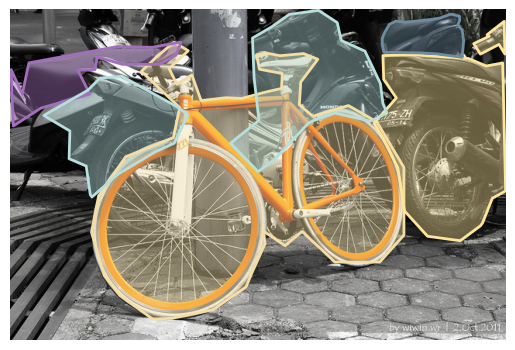


<class 'int'> 365841
2817
[59303, 59304]
ann_id:  1918725
False the carrot and celery under the chicken wing
False sliced carrots under the chicken wings
True (parent: 59303),  the banana and celery under the chicken wing
True (parent: 59304),  sliced papayas under the chicken wings

Displaying image: {'license': 3, 'file_name': 'COCO_train2014_000000365841.jpg', 'coco_url': 'http://mscoco.org/images/365841', 'height': 426, 'width': 640, 'date_captured': '2013-11-21 04:58:46', 'flickr_url': 'http://farm2.staticflickr.com/1235/5137509011_cc51b339eb_z.jpg', 'id': 365841}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000365841.jpg
Ann count:  5


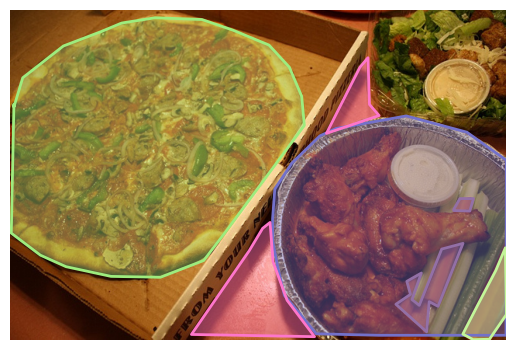


<class 'int'> 134937
19886
[34699, 34700]
ann_id:  1739784
False person on left
False a man wearing red with his right leg outstretched
True (parent: 34699),  person on right
True (parent: 34700),  a woman wearing red with her left leg outstretched

27292
[52100, 52101]
ann_id:  504448
False a young man wearing black and orange shorts and sunglasses who is spinning a frisbee
False man wearing black and orange shorts and white tee shirt holding a frisbee
True (parent: 52100),  a young woman wearing black and orange shorts and sunglasses who is spinning a hula hoop
True (parent: 52101),  woman wearing black and orange shorts and white tee shirt holding a beach ball

Displaying image: {'license': 3, 'file_name': 'COCO_train2014_000000134937.jpg', 'coco_url': 'http://mscoco.org/images/134937', 'height': 480, 'width': 640, 'date_captured': '2013-11-18 17:10:30', 'flickr_url': 'http://farm4.staticflickr.com/3124/2564749846_0068de5971_z.jpg', 'id': 134937}
Img path:  /shared/gbiamby/data/coc

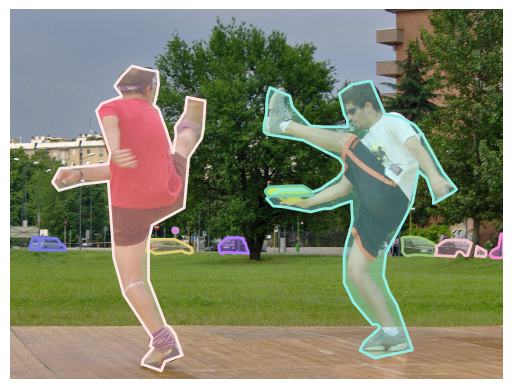


<class 'int'> 307881
1338
[28323, 28324]
ann_id:  490448
False woman using the pink toothbrush
False girl on right
True (parent: 28323),  woman using the purple toothbrush
True (parent: 28324),  boy on right

37835
[76804, 76805]
ann_id:  512780
False the woman with the white and green tooth brush
False a girl brushing her teeth with a blue toothbrush
True (parent: 76804),  the woman with the orange and green tooth brush
True (parent: 76805),  a boy brushing her teeth with a red toothbrush

Displaying image: {'license': 4, 'file_name': 'COCO_train2014_000000307881.jpg', 'coco_url': 'http://mscoco.org/images/307881', 'height': 375, 'width': 500, 'date_captured': '2013-11-21 20:32:52', 'flickr_url': 'http://farm4.staticflickr.com/3123/2303803375_341529fed1_z.jpg', 'id': 307881}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000307881.jpg
Ann count:  5


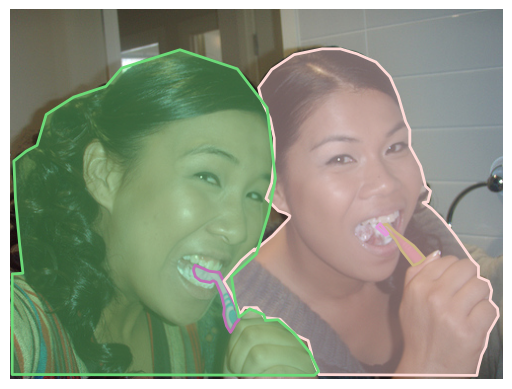


<class 'int'> 49878
18653
[31884, 31885]
ann_id:  1995802
False doll in the left most top corner side of the image
False a white teddy bear is dressed in silver
True (parent: 31884),  doll in the right most top corner side of the image
True (parent: 31885),  a purple teddy bear is dressed in gold

19298
[33373, 33374]
ann_id:  1995489
False handmade bear dressed in tin foil to look like a gladiator
False a dark brown teddy bear wearing armor in between two other stuffed animals
True (parent: 33373),  handmade bunny dressed in tin foil to look like a gladiator
True (parent: 33374),  a dark purple bunny wearing armor in between two other stuffed animals

39625
[80932, 80933]
ann_id:  1995424
False a large bear holding a sword with no head
False a stuffed bear holding onto a silver stick
True (parent: 80932),  a large bunny holding a shield with no head
True (parent: 80933),  a stuffed bunny holding onto a gold stick

Displaying image: {'license': 4, 'file_name': 'COCO_train2014_00000004

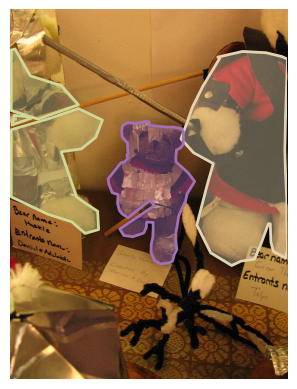


<class 'int'> 517985
16623
[27141, 27142]
ann_id:  1056900
False the green vegetable in the left
False green vegetable by brown food
True (parent: 27141),  the purple vegetable in the left
True (parent: 27142),  purple vegetable by brown food

24771
[46225, 46226]
ann_id:  1532012
False chinese food rests in a blue dish with broccoli and tiny corn
False a dish of food containing broccoli , mushroom , beansprouts and corn
True (parent: 46225),  chinese food rests in a pink dish with broccoli and tiny corn
True (parent: 46226),  a dish of food containing broccoli , mushroom , beansprouts and pineapple

41177
[84622, 84623]
ann_id:  1056448
False broccoli above the piece of baby corn
False broccoli on top of the corn
True (parent: 84622),  broccoli above the piece of baby pineapple
True (parent: 84623),  broccoli on top of the pineapple

Displaying image: {'license': 1, 'file_name': 'COCO_train2014_000000517985.jpg', 'coco_url': 'http://mscoco.org/images/517985', 'height': 480, 'width': 

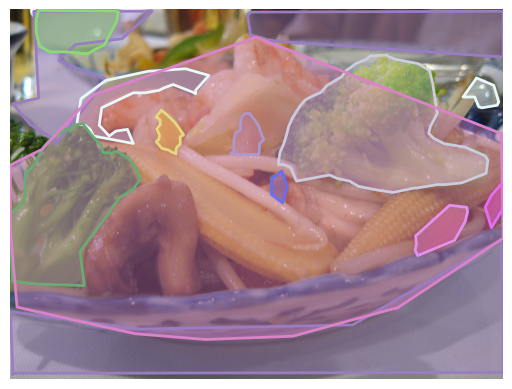


<class 'int'> 322720
26548
[50396, 50397]
ann_id:  1088319
False chocolate cake decorated with toy bulldozers
False the sheet cake including its decorations
True (parent: 50396),  chocolate cake decorated with toy unicorns
True (parent: 50397),  the sheet cake including its toppings

Displaying image: {'license': 1, 'file_name': 'COCO_train2014_000000322720.jpg', 'coco_url': 'http://mscoco.org/images/322720', 'height': 427, 'width': 640, 'date_captured': '2013-11-20 21:15:40', 'flickr_url': 'http://farm9.staticflickr.com/8112/8503184965_f0d0c5464e_z.jpg', 'id': 322720}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000322720.jpg
Ann count:  6


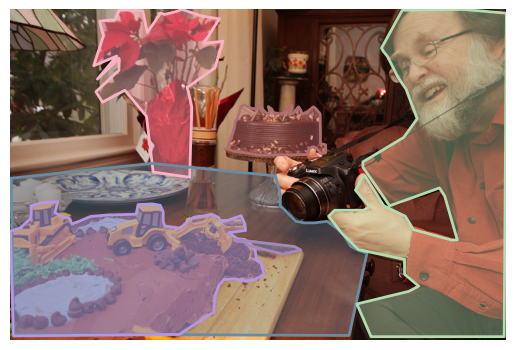


<class 'int'> 271183
45669
[95049, 95050]
ann_id:  48627
False closest cat
False a cat with his head turned away
True (parent: 95049),  closest dog
True (parent: 95050),  a dog with his head turned away

Displaying image: {'license': 3, 'file_name': 'COCO_train2014_000000271183.jpg', 'coco_url': 'http://mscoco.org/images/271183', 'height': 459, 'width': 640, 'date_captured': '2013-11-17 20:29:34', 'flickr_url': 'http://farm3.staticflickr.com/2481/4097368768_6aa5636304_z.jpg', 'id': 271183}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000271183.jpg
Ann count:  3


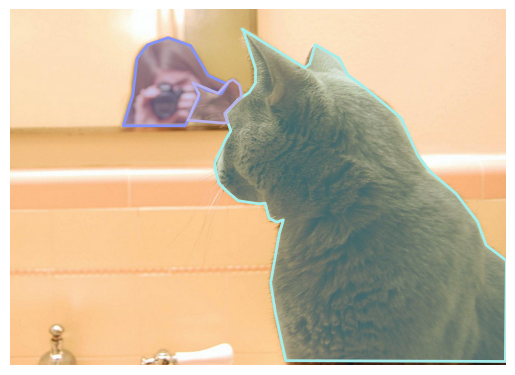


<class 'int'> 229024
19039
[32789, 32790]
ann_id:  505229
False a baseball player resting his arm on a bat
False a baseball player in a blue , gray and white uniform sitting on an empty sunflower seed container
True (parent: 32789),  a soccer player resting his arm on a ball
True (parent: 32790),  a soccer player in a orange , gray and white uniform sitting on an empty pizza box

Displaying image: {'license': 1, 'file_name': 'COCO_train2014_000000229024.jpg', 'coco_url': 'http://mscoco.org/images/229024', 'height': 640, 'width': 427, 'date_captured': '2013-11-23 00:56:19', 'flickr_url': 'http://farm8.staticflickr.com/7274/6984174114_c17a849cc3_z.jpg', 'id': 229024}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000229024.jpg
Ann count:  3


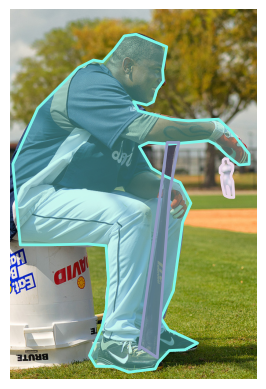


<class 'int'> 165160
41869
[86212, 86213]
ann_id:  402374
False traffic signal light
False the traffic light that is currently red
True (parent: 86212),  traffic signal whistle
True (parent: 86213),  the traffic whistle that is currently red

Displaying image: {'license': 5, 'file_name': 'COCO_train2014_000000165160.jpg', 'coco_url': 'http://mscoco.org/images/165160', 'height': 480, 'width': 640, 'date_captured': '2013-11-16 18:24:02', 'flickr_url': 'http://farm1.staticflickr.com/2/2592200_1dbeee58c8_z.jpg', 'id': 165160}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000165160.jpg
Ann count:  5


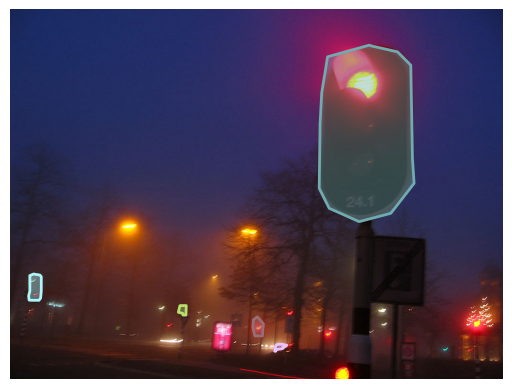


<class 'int'> 80554
12020
[16335, 16336]
ann_id:  183303
False a woman in glasses and in a pink shirt playing wii
False a woman in a pink shirt swinging a game control
True (parent: 16335),  a woman in glasses and in a purple shirt playing wii
True (parent: 16336),  a woman in a purple shirt swinging a game control

17568
[29371, 29372]
ann_id:  200230
False a woman in a brown shirt holding a wii controller
False a woman wearing shorts
True (parent: 29371),  a woman in a brown shirt holding a wii controller
True (parent: 29372),  a woman wearing jeans

Displaying image: {'license': 1, 'file_name': 'COCO_train2014_000000080554.jpg', 'coco_url': 'http://mscoco.org/images/80554', 'height': 426, 'width': 640, 'date_captured': '2013-11-21 22:02:11', 'flickr_url': 'http://farm4.staticflickr.com/3077/2621941710_7e6a521005_z.jpg', 'id': 80554}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000080554.jpg
Ann count:  5


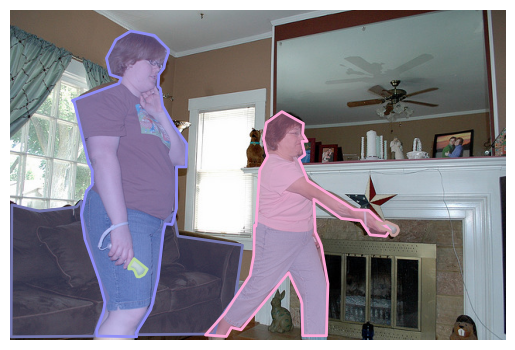


<class 'int'> 97563
18872
[32394, 32395]
ann_id:  1758505
False the man running behind the frisbee
False a guy with adidas sockjs
True (parent: 32394),  the dog running behind the cheeseburger
True (parent: 32395),  a guy with nike sockjs

19735
[34358, 34359]
ann_id:  1749635
False a man in a white shirt with a red design
False a man in white trying to catch a frisbie
True (parent: 34358),  a man in a blue shirt with a green design
True (parent: 34359),  a man in black trying to catch a frisbie

39806
[81380, 81381]
ann_id:  431724
False a man wearing a gray shirt about to throw a frisbee
False a man in a blue shirt with the numbers 01 printed on the back , preparing to pass a frisbee
True (parent: 81380),  a man wearing a yellow shirt about to throw a frisbee
True (parent: 81381),  a man in a red shirt with the numbers 02 printed on the back, preparing to pass a frisbee

Displaying image: {'license': 1, 'file_name': 'COCO_train2014_000000097563.jpg', 'coco_url': 'http://mscoco.org/i

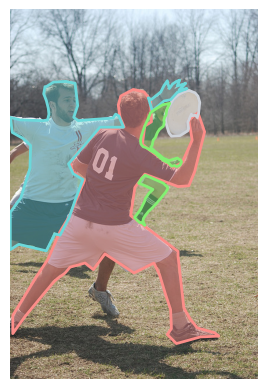


<class 'int'> 50961
5486
[1142, 1143]
ann_id:  1642197
False the industrial kitchen stove
False this is a stove with four burners
True (parent: 1142),  the magical kitchen stove

27503
[52584, 52585]
ann_id:  1127422
False oven with yellow caution
False a tall oven with a pan and copper pot on it
True (parent: 52584),  oven with purple caution
True (parent: 52585),  a tall oven with a cauldron and crystal ball on it

32699
[64753]
ann_id:  1642918
False oven fixed on the top of the gas stove
True (parent: 64753),  oven fixed on the top of the fire-breathing stove

Displaying image: {'license': 5, 'file_name': 'COCO_train2014_000000050961.jpg', 'coco_url': 'http://mscoco.org/images/50961', 'height': 480, 'width': 640, 'date_captured': '2013-11-14 22:53:29', 'flickr_url': 'http://farm4.staticflickr.com/3074/2640905382_fe6ccd5a1a_z.jpg', 'id': 50961}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000050961.jpg
Ann count:  8


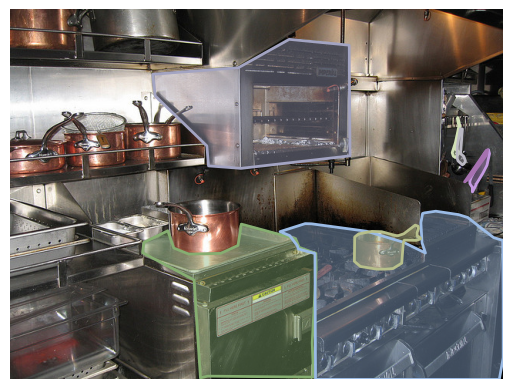


<class 'int'> 437446
15481
[24374, 24375]
ann_id:  1161609
False the grey teddy bear sits amongst other teddy bears
False gray crochet doll next to two other dolls
True (parent: 24374),  the green alien sits amongst other teddy bears
True (parent: 24375),  blue crochet doll next to two other dolls

16119
[25925, 25926]
ann_id:  1159634
False a multicolored teddy bear in the center
False a rainbow colored bear made of yarn
True (parent: 25925),  a unicorn teddy bear in the center
True (parent: 25926),  a galaxy colored bear made of yarn

40089
[82043, 82044]
ann_id:  1162651
False the yellow knit bear
False a yellow knitted teddy bear on the right next to a rainbow colored teddy bear
True (parent: 82043),  the pink knit bear
True (parent: 82044),  a purple knitted teddy bear on the right next to a galaxy colored teddy bear

Displaying image: {'license': 3, 'file_name': 'COCO_train2014_000000437446.jpg', 'coco_url': 'http://mscoco.org/images/437446', 'height': 612, 'width': 612, 'date_c

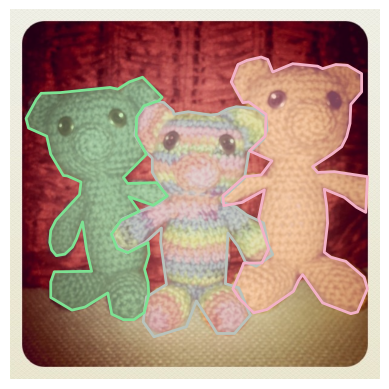


<class 'int'> 552114
7066
[4865, 4866]
ann_id:  1539091
False the centre cubical of the box
False middle part of the lunch box
True (parent: 4865),  the centre pyramid of the box

48001
[100405, 100406]
ann_id:  1534641
False an array of food in a green dish
False rice , beans , and tomato
True (parent: 100405),  an assortment of food in a green dish
True (parent: 100406),  rice , beans , and broccoli

48283
[101085, 101086]
ann_id:  1540234
False pieces of apple in the right bottom side of the image
False a lot of apple parts
True (parent: 101085),  pieces of banana in the right bottom side of the image
True (parent: 101086),  a lot of banana parts

Displaying image: {'license': 2, 'file_name': 'COCO_train2014_000000552114.jpg', 'coco_url': 'http://mscoco.org/images/552114', 'height': 375, 'width': 500, 'date_captured': '2013-11-19 20:29:56', 'flickr_url': 'http://farm2.staticflickr.com/1259/625999878_5fe17411e2_z.jpg', 'id': 552114}
Img path:  /shared/gbiamby/data/coco/train2014/COC

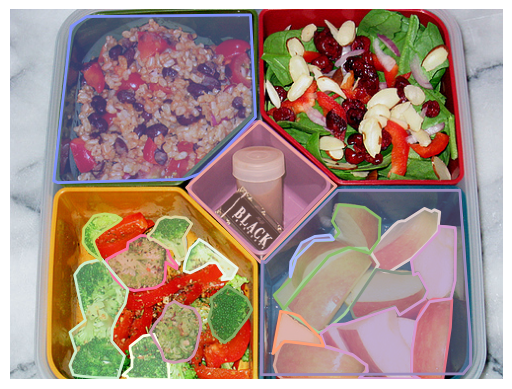


<class 'int'> 308522
1571
[33655, 33656]
ann_id:  478079
False a girl holding a toy monkey
False a woman in a black shirt holding balloon animals
True (parent: 33655),  a girl holding a toy tiger
True (parent: 33656),  a woman in a black shirt holding unicorn animals

39577
[80825, 80826]
ann_id:  485290
False women in red stripe shirt
False a woman sitting at a table with black hair and and red and white striped shirt
True (parent: 80825),  women in blue stripe shirt
True (parent: 80826),  a woman sitting at a table with blonde hair and and blue and white striped shirt

47712
[99716, 99717]
ann_id:  1873900
False a glass of wine next to a monkey balloon
False glass with water in the right side of the image
True (parent: 99716),  a glass of juice next to a monkey balloon
True (parent: 99717),  glass with milk in the right side of the image

Displaying image: {'license': 4, 'file_name': 'COCO_train2014_000000308522.jpg', 'coco_url': 'http://mscoco.org/images/308522', 'height': 600, 'wi

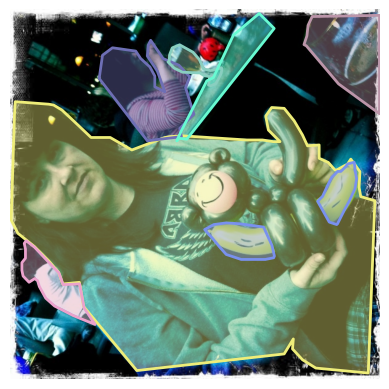


<class 'int'> 424844
8841
[8945, 8946]
ann_id:  467020
False a woman puts a spoon on a chocolate dessert
False woman in a green and white shirt
True (parent: 8945),  a woman puts a spoon on a pineapple dessert
True (parent: 8946),  woman in a purple and white shirt

27867
[53427, 53428]
ann_id:  1737575
False black and white striped shirt of the person behind the diner in the foreground
False the back of a person with white shirt in the background
True (parent: 53427),  red and white striped shirt of the person behind the diner in the foreground

Displaying image: {'license': 3, 'file_name': 'COCO_train2014_000000424844.jpg', 'coco_url': 'http://mscoco.org/images/424844', 'height': 640, 'width': 480, 'date_captured': '2013-11-15 19:36:09', 'flickr_url': 'http://farm4.staticflickr.com/3004/2797418550_07b25b279d_z.jpg', 'id': 424844}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000424844.jpg
Ann count:  8


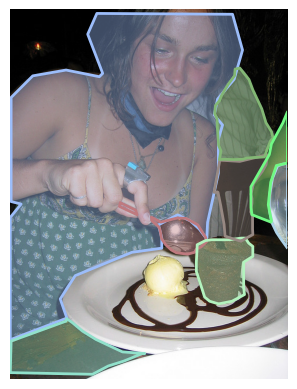


<class 'int'> 209537
14800
[22780, 22781]
ann_id:  1713338
False a fat white man in a black shirt
False man in black shirt eating at an outside table
True (parent: 22780),  a slim white man in a black shirt
True (parent: 22781),  man in black shirt sleeping at an outside table

35675
[71730, 71731]
ann_id:  489342
False a man weraing glasses , a gray sweatshort with writing on it , sitting at a table
False a man in a wisconsin university hoodie is sitting at a blue table with a nearly empty bowl in front of him
True (parent: 71730),  a man weraing glasses , a gray sweatshort with cartoon on it , sitting at a table
True (parent: 71731),  a man in a california university hoodie is sitting at a red table with a nearly full bowl in front of him

Displaying image: {'license': 4, 'file_name': 'COCO_train2014_000000209537.jpg', 'coco_url': 'http://mscoco.org/images/209537', 'height': 480, 'width': 640, 'date_captured': '2013-11-24 23:35:35', 'flickr_url': 'http://farm9.staticflickr.com/8545/

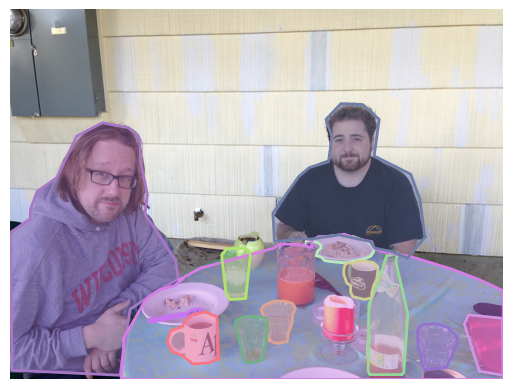


<class 'int'> 36017
33104
[65680, 65681]
ann_id:  392212
False the nearest part of the table with wine glasses and crackers in a bowl
False a table covered in wine glasses
True (parent: 65681),  a table covered in water glasses

Displaying image: {'license': 1, 'file_name': 'COCO_train2014_000000036017.jpg', 'coco_url': 'http://mscoco.org/images/36017', 'height': 480, 'width': 640, 'date_captured': '2013-11-19 23:57:24', 'flickr_url': 'http://farm8.staticflickr.com/7188/6832371074_36851706ea_z.jpg', 'id': 36017}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000036017.jpg
Ann count:  32


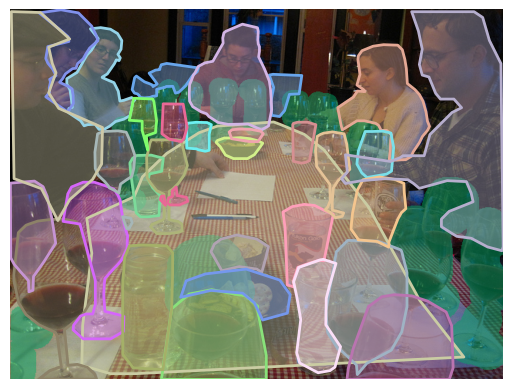


<class 'int'> 313932
32429
[64130]
ann_id:  1618455
False a long wooden platform holding several objects
True (parent: 64130),  a tall silver platform holding several robots

Displaying image: {'license': 4, 'file_name': 'COCO_train2014_000000313932.jpg', 'coco_url': 'http://mscoco.org/images/313932', 'height': 480, 'width': 640, 'date_captured': '2013-11-15 19:30:14', 'flickr_url': 'http://farm7.staticflickr.com/6189/6071620976_3d4e1bf110_z.jpg', 'id': 313932}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000313932.jpg
Ann count:  11


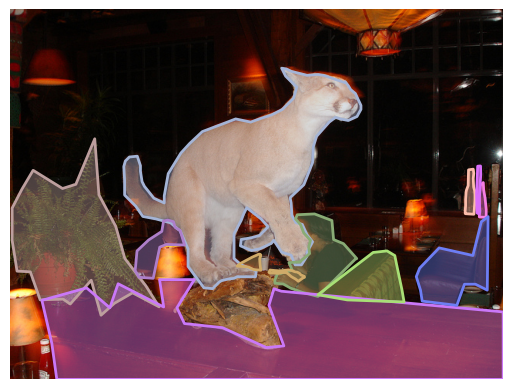


<class 'int'> 327462
9016
[9357]
ann_id:  618456
False snowboard of fallen person
True (parent: 9357),  bicycle of fallen person

10796
[13501, 13502]
ann_id:  511207
False the person sitting in the snow
False a snowboarder that is sitting on the ground
True (parent: 13501),  the person laying in the grass
True (parent: 13502),  a skateboarder that is sitting on the ground

20069
[35134]
ann_id:  457933
False large man in blue , black and white standing on a snowboard
True (parent: 35134),  large woman in pink, purple and black standing on a skateboard

Displaying image: {'license': 1, 'file_name': 'COCO_train2014_000000327462.jpg', 'coco_url': 'http://mscoco.org/images/327462', 'height': 512, 'width': 640, 'date_captured': '2013-11-20 14:21:30', 'flickr_url': 'http://farm4.staticflickr.com/3232/2305750356_4d6ecc28b2_z.jpg', 'id': 327462}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000327462.jpg
Ann count:  8


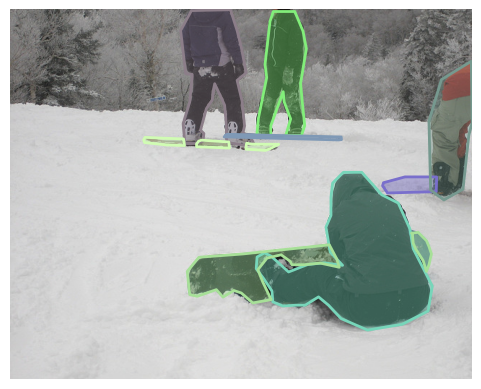


<class 'int'> 369217
23546
[43378, 43379]
ann_id:  381276
False the chair on the left , opposite the fence
False an wooden arm char at the table
True (parent: 43378),  the couch on the left , opposite the fence
True (parent: 43379),  an plastic arm char at the table

45050
[93573]
ann_id:  1394211
False a wooden bench at a table
True (parent: 93573),  a plastic bench at a table

Displaying image: {'license': 3, 'file_name': 'COCO_train2014_000000369217.jpg', 'coco_url': 'http://mscoco.org/images/369217', 'height': 427, 'width': 640, 'date_captured': '2013-11-16 17:00:55', 'flickr_url': 'http://farm9.staticflickr.com/8295/7945311042_d941b9a602_z.jpg', 'id': 369217}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000369217.jpg
Ann count:  5


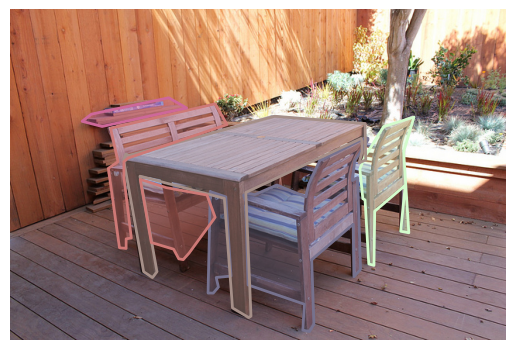


<class 'int'> 477563
36129
[72813, 72814]
ann_id:  152150
False a red motorbike stands with its rider on planks balanced atop three rowboats
False a bike one girl sitting on it & they are in boat
True (parent: 72813),  a purple motorbike stands with its rider on planks balanced atop three rowboats
True (parent: 72814),  a car one girl sitting on it & they are in boat

Displaying image: {'license': 1, 'file_name': 'COCO_train2014_000000477563.jpg', 'coco_url': 'http://mscoco.org/images/477563', 'height': 480, 'width': 640, 'date_captured': '2013-11-18 05:24:23', 'flickr_url': 'http://farm6.staticflickr.com/5515/9598977190_6c5543e572_z.jpg', 'id': 477563}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000477563.jpg
Ann count:  12


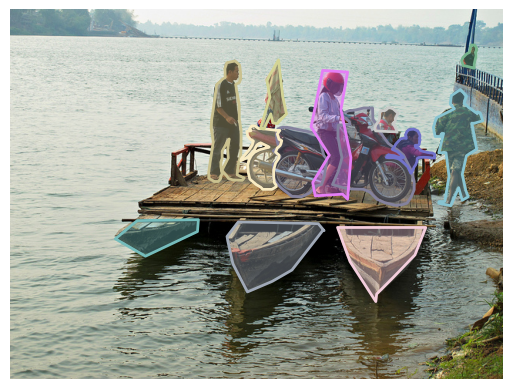


<class 'int'> 510232
13625
[20056, 20057]
ann_id:  2167464
False a girl in a red and paisley dress tying a red patterened man ' s tie around her neck
False a woman in a red and floral dress wearing sunglasses laughing
True (parent: 20056),  a girl in a yellow and paisley dress tying a yellow patterened man ' s tie around her neck
True (parent: 20057),  a woman in a green and floral dress wearing sunglasses laughing

Displaying image: {'license': 3, 'file_name': 'COCO_train2014_000000510232.jpg', 'coco_url': 'http://mscoco.org/images/510232', 'height': 640, 'width': 417, 'date_captured': '2013-11-18 03:11:30', 'flickr_url': 'http://farm7.staticflickr.com/6178/6207083912_cf7962bf88_z.jpg', 'id': 510232}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000510232.jpg
Ann count:  3


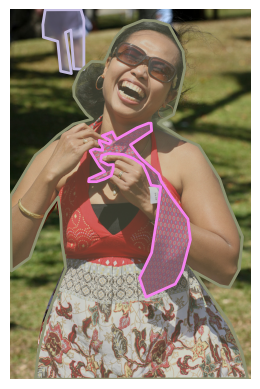


<class 'int'> 572174
18903
[32462, 32463]
ann_id:  315226
False the floral blanket the woman is sitting on
False tan comforter with flower pattern under girl
True (parent: 32462),  the camouflage blanket the woman is sitting on
True (parent: 32463),  tan comforter with polka dot pattern under girl

22628
[41224, 41225]
ann_id:  2225518
False bed is under the laptop
False the end of a bed which is not covered by the comforter
True (parent: 41224),  bed is under the computer
True (parent: 41225),  the foot of a bed which is not covered by the comforter

Displaying image: {'license': 5, 'file_name': 'COCO_train2014_000000572174.jpg', 'coco_url': 'http://mscoco.org/images/572174', 'height': 412, 'width': 640, 'date_captured': '2013-11-21 00:36:36', 'flickr_url': 'http://farm9.staticflickr.com/8463/8420806461_0bb04aaece_z.jpg', 'id': 572174}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000572174.jpg
Ann count:  4


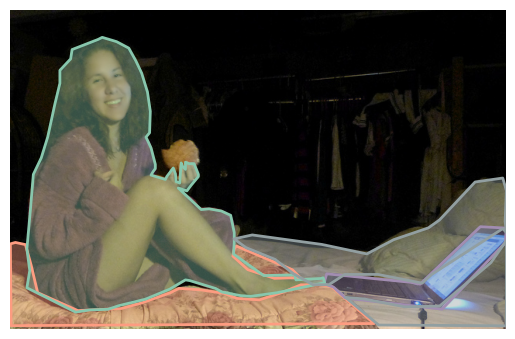


<class 'int'> 386694
8155
[7380, 7381]
ann_id:  445692
False an older gentleman with gray hair and glasses wearing an orange hawaiian shirt
False a man in a red shirt
True (parent: 7380),  an older gentleman with gray hair and glasses wearing a green hawaiian shirt
True (parent: 7381),  a woman in a blue shirt

29922
[58263, 58264]
ann_id:  464613
False old woman
False a women was smilling
True (parent: 58263),  old man
True (parent: 58264),  a man was smilling

Displaying image: {'license': 6, 'file_name': 'COCO_train2014_000000386694.jpg', 'coco_url': 'http://mscoco.org/images/386694', 'height': 640, 'width': 480, 'date_captured': '2013-11-24 22:15:07', 'flickr_url': 'http://farm9.staticflickr.com/8172/8016379074_974d31957c_z.jpg', 'id': 386694}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000386694.jpg
Ann count:  12


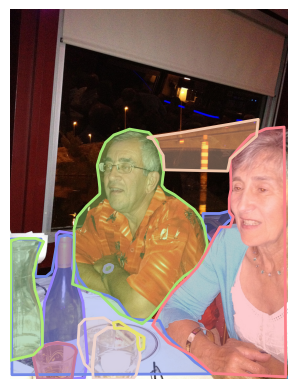


<class 'int'> 314845
577
[12537, 12538]
ann_id:  1568284
False a hot dog with tomatoes and a pickles
False the hot dog with the pickle and tomatoes
True (parent: 12537),  a pizza with tomatoes and a pickles
True (parent: 12538),  the pizza with the pickle and tomatoes

Displaying image: {'license': 2, 'file_name': 'COCO_train2014_000000314845.jpg', 'coco_url': 'http://mscoco.org/images/314845', 'height': 428, 'width': 640, 'date_captured': '2013-11-20 13:11:08', 'flickr_url': 'http://farm4.staticflickr.com/3114/2656250206_94595737e3_z.jpg', 'id': 314845}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000314845.jpg
Ann count:  8


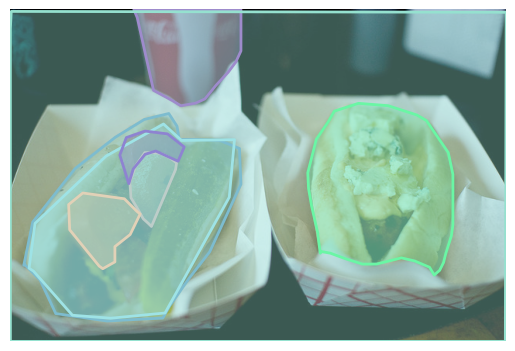


<class 'int'> 105640
47876
[100100, 100101]
ann_id:  435724
False the woman with the umbrella
False a woman wearing a heavy coat and holding a red umbrella walking on a path
True (parent: 100100),  the clown with the umbrella
True (parent: 100101),  a clown wearing a heavy coat and holding a red umbrella walking on a path

Displaying image: {'license': 3, 'file_name': 'COCO_train2014_000000105640.jpg', 'coco_url': 'http://mscoco.org/images/105640', 'height': 640, 'width': 640, 'date_captured': '2013-11-18 06:06:58', 'flickr_url': 'http://farm8.staticflickr.com/7196/6865400749_1d9385e5d5_z.jpg', 'id': 105640}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000105640.jpg
Ann count:  13


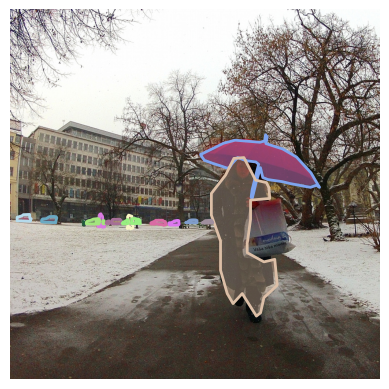


<class 'int'> 475988
7383
[5592, 5593]
ann_id:  155169
False only motorcycle that is completely visible
False a red and white motorbike with the word marlboro on it
True (parent: 5592),  only tricycle that is completely visible
True (parent: 5593),  a purple and white motorbike with the word fairy on it

Displaying image: {'license': 3, 'file_name': 'COCO_train2014_000000475988.jpg', 'coco_url': 'http://mscoco.org/images/475988', 'height': 439, 'width': 640, 'date_captured': '2013-11-15 19:46:19', 'flickr_url': 'http://farm8.staticflickr.com/7122/7574980840_b8050d1613_z.jpg', 'id': 475988}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000475988.jpg
Ann count:  7


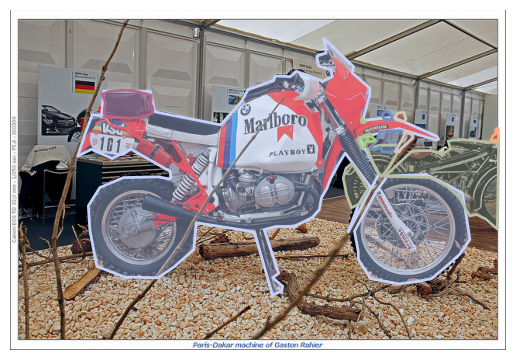


<class 'int'> 56193
21100
[37627, 37628]
ann_id:  1375920
False the left bus is grey and yellow
False the boat and the bridge behind the first boat from the front
True (parent: 37627),  the left bus is purple and yellow
True (parent: 37628),  the spaceship and the bridge behind the first spaceship from the front

Displaying image: {'license': 4, 'file_name': 'COCO_train2014_000000056193.jpg', 'coco_url': 'http://mscoco.org/images/56193', 'height': 333, 'width': 500, 'date_captured': '2013-11-16 16:19:57', 'flickr_url': 'http://farm1.staticflickr.com/1/1263332_232e54ba87_z.jpg', 'id': 56193}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000056193.jpg
Ann count:  2


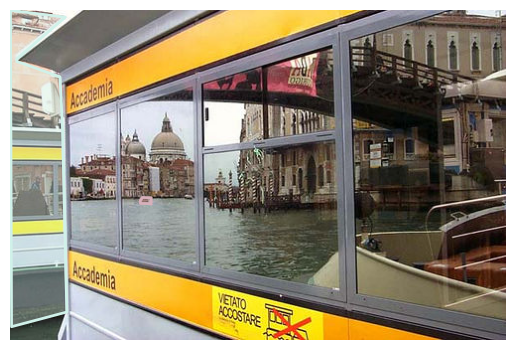


<class 'int'> 560517
13053
[18722, 18723]
ann_id:  1038748
False a wooden bowl with the word nnizhigu on it
False the bamboo steamer basket
True (parent: 18722),  a wooden bowl with the word trusepvu on it
True (parent: 18723),  the metal steamer basket

37496
[76022, 76023]
ann_id:  2108085
False a plate of green vegetables
False green leafy vegetables
True (parent: 76022),  a plate of purple vegetables
True (parent: 76023),  purple leafy vegetables

Displaying image: {'license': 3, 'file_name': 'COCO_train2014_000000560517.jpg', 'coco_url': 'http://mscoco.org/images/560517', 'height': 428, 'width': 640, 'date_captured': '2013-11-19 23:44:04', 'flickr_url': 'http://farm4.staticflickr.com/3043/2916630199_fe79ea64c1_z.jpg', 'id': 560517}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000560517.jpg
Ann count:  3


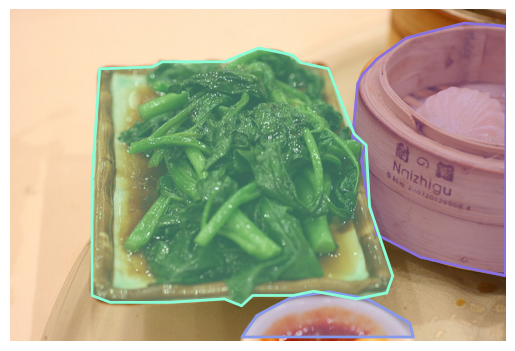


<class 'int'> 403329
41290
[84872, 84873]
ann_id:  1634894
False keyboard from laptop with a lot of blue in its screen
False laptop keyboard on right side
True (parent: 84872),  mouse from laptop with a lot of blue in its screen
True (parent: 84873),  laptop mouse on right side

41839
[86149]
ann_id:  1634142
False the keyboard on th elaptop that has no markings or stickers in the wrist rest area
True (parent: 86149),  the mouse on the laptop that has no markings or stickers in the wrist rest area

48989
[102692, 102693]
ann_id:  1099584
False the apple computer
False a laptop with a word processor open
True (parent: 102692),  the orange computer
True (parent: 102693),  a laptop with a calculator open

Displaying image: {'license': 3, 'file_name': 'COCO_train2014_000000403329.jpg', 'coco_url': 'http://mscoco.org/images/403329', 'height': 478, 'width': 640, 'date_captured': '2013-11-24 00:09:37', 'flickr_url': 'http://farm8.staticflickr.com/7143/6575576719_f57dc6c893_z.jpg', 'id': 4033

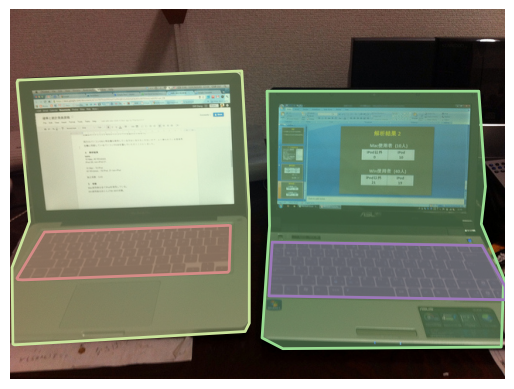


<class 'int'> 466145
14527
[22152, 22153]
ann_id:  1933111
False the back right chair
False the background chair to the right of the coffee
True (parent: 22153),  the background stool to the right of the coffee

33974
[67759, 67760]
ann_id:  1930369
False a blue chair directly behind of a coffee cup
False the chair that is behind the coffee cup
True (parent: 67759),  a yellow chair directly behind of a coffee cup
True (parent: 67760),  the chair that is behind the coffee mug

Displaying image: {'license': 2, 'file_name': 'COCO_train2014_000000466145.jpg', 'coco_url': 'http://mscoco.org/images/466145', 'height': 480, 'width': 640, 'date_captured': '2013-11-20 13:29:08', 'flickr_url': 'http://farm1.staticflickr.com/112/310650457_7cb053dd30_z.jpg', 'id': 466145}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000466145.jpg
Ann count:  6


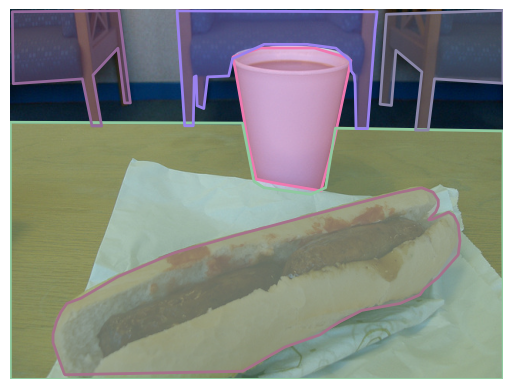


<class 'int'> 94004
48144
[100753, 100754]
ann_id:  1479182
False the surfboard under the person
False the surf board of the surfer
True (parent: 100753),  the skateboard under the person
True (parent: 100754),  the skate board of the surfer

Displaying image: {'license': 4, 'file_name': 'COCO_train2014_000000094004.jpg', 'coco_url': 'http://mscoco.org/images/94004', 'height': 427, 'width': 640, 'date_captured': '2013-11-20 20:19:49', 'flickr_url': 'http://farm9.staticflickr.com/8545/8669800015_67d1d545e6_z.jpg', 'id': 94004}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000094004.jpg
Ann count:  3


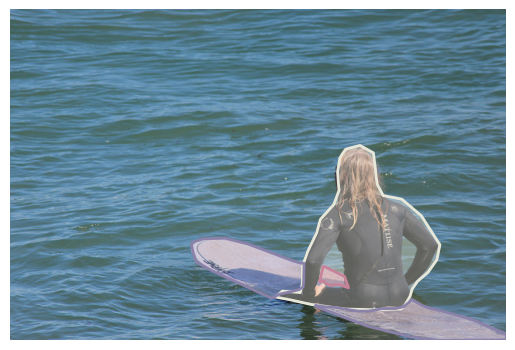


<class 'int'> 397877
9292
[9995, 9996]
ann_id:  454684
False the little girl sitting on the bed with the striped shirt
False girl wearing pink shirt and jeans sits on a bed next to a desk
True (parent: 9995),  the little boy sitting on the bed with the striped shirt
True (parent: 9996),  boy wearing pink shirt and jeans sits on a bed next to a desk

Displaying image: {'license': 4, 'file_name': 'COCO_train2014_000000397877.jpg', 'coco_url': 'http://mscoco.org/images/397877', 'height': 640, 'width': 480, 'date_captured': '2013-11-20 23:37:44', 'flickr_url': 'http://farm6.staticflickr.com/5288/5232661267_331acf5d54_z.jpg', 'id': 397877}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000397877.jpg
Ann count:  6


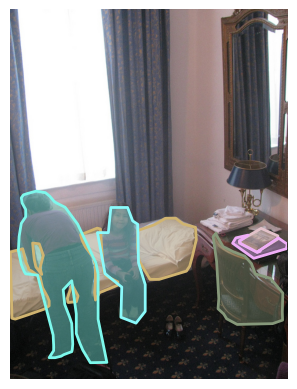


<class 'int'> 580585
64
[1139, 1140]
ann_id:  2174167
False reflection of the bird in the mirror
False a reflection of a green love parrot in the mirror
True (parent: 1139),  reflection of the toaster in the mirror
True (parent: 1140),  a reflection of a purple love parrot in the mirror

27578
[52758, 52759]
ann_id:  39148
False green bird in a cage looking at the camera
False a green bird with a red beak sitting on a branch
True (parent: 52758),  purple bird in a bucket looking at the camera
True (parent: 52759),  a purple bird with a blue beak sitting on a cloud

Displaying image: {'license': 4, 'file_name': 'COCO_train2014_000000580585.jpg', 'coco_url': 'http://mscoco.org/images/580585', 'height': 240, 'width': 320, 'date_captured': '2013-11-17 00:31:19', 'flickr_url': 'http://farm3.staticflickr.com/2312/2473663154_0109a0259f_z.jpg', 'id': 580585}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000580585.jpg
Ann count:  3


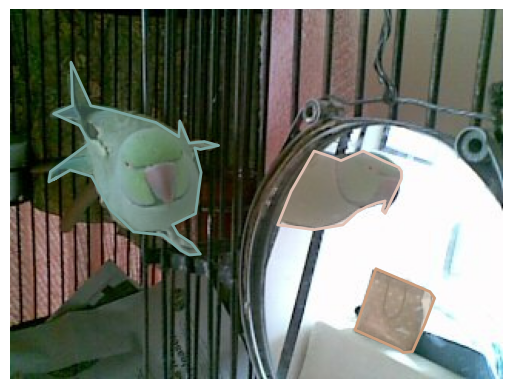


<class 'int'> 581136
26820
[51028, 51029]
ann_id:  1949970
False a striped couch in the shade with a pink pillow on it
False chair on right side
True (parent: 51028),  a polka dot couch in the shade with a pink pillow on it
True (parent: 51029),  table on right side

48983
[102681, 102682]
ann_id:  113430
False striped chair with pink pillow on it
False a striped sofa chair with pink cushion which is a part of full sofa set and a table in a sitting room
True (parent: 102681),  striped chair with blue pillow on it
True (parent: 102682),  a striped sofa chair with pink cushion which is a part of full sofa set and a bookshelf in a sitting room

Displaying image: {'license': 1, 'file_name': 'COCO_train2014_000000581136.jpg', 'coco_url': 'http://mscoco.org/images/581136', 'height': 495, 'width': 640, 'date_captured': '2013-11-21 21:22:30', 'flickr_url': 'http://farm9.staticflickr.com/8545/8698373846_840eda59a6_z.jpg', 'id': 581136}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2

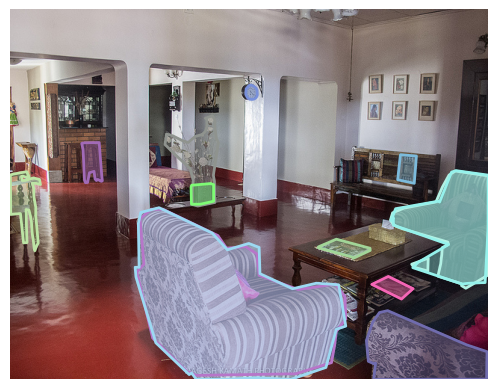


<class 'int'> 232801
8673
[8559, 8560]
ann_id:  444495
False a woman holding a pink umbrella
False a woman in a bikini holding a pink umbrella
True (parent: 8559),  a man holding a pink book
True (parent: 8560),  a man in a bikini holding a pink book

Displaying image: {'license': 4, 'file_name': 'COCO_train2014_000000232801.jpg', 'coco_url': 'http://mscoco.org/images/232801', 'height': 427, 'width': 640, 'date_captured': '2013-11-18 05:57:06', 'flickr_url': 'http://farm4.staticflickr.com/3056/2768637531_6d2a39c687_z.jpg', 'id': 232801}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000232801.jpg
Ann count:  5


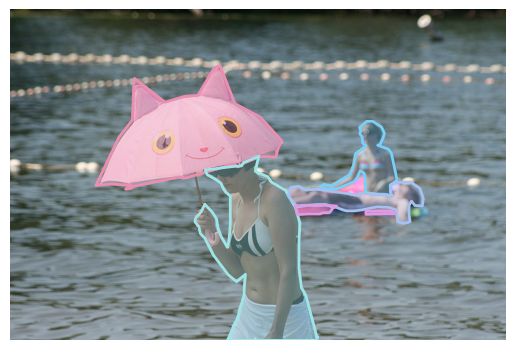


<class 'int'> 427920
5570
[1333, 1334]
ann_id:  284446
False the blue umbrella that is set in between the two chairs that are in the foreground
False blue color umbrella in the image
True (parent: 1333),  the purple umbrella that is set in between the two chairs that are in the foreground
True (parent: 1334),  purple color umbrella in the image

Displaying image: {'license': 5, 'file_name': 'COCO_train2014_000000427920.jpg', 'coco_url': 'http://mscoco.org/images/427920', 'height': 640, 'width': 480, 'date_captured': '2013-11-18 08:11:58', 'flickr_url': 'http://farm3.staticflickr.com/2894/10278080575_f1a1f3c38e_z.jpg', 'id': 427920}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000427920.jpg
Ann count:  15


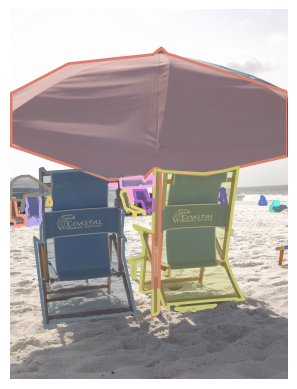


<class 'int'> 109654
13135
[18921, 18922]
ann_id:  575496
False a stone bench that doesnt have an animal in front of it
False a low bench on the left side of an entrance gate
True (parent: 18921),  a stone bench that doesnt have a robot in front of it
True (parent: 18922),  a low bench on the left side of an entrance fence

Displaying image: {'license': 5, 'file_name': 'COCO_train2014_000000109654.jpg', 'coco_url': 'http://mscoco.org/images/109654', 'height': 425, 'width': 640, 'date_captured': '2013-11-17 22:56:12', 'flickr_url': 'http://farm8.staticflickr.com/7145/6491150391_15649d760d_z.jpg', 'id': 109654}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000109654.jpg
Ann count:  3


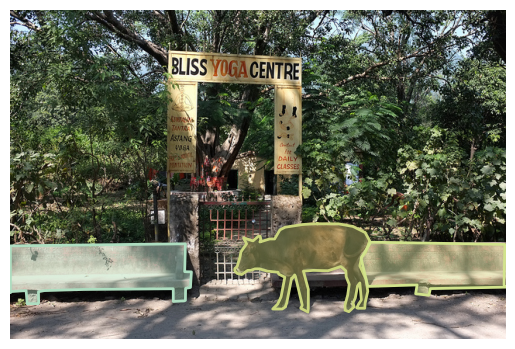

In [159]:
# load and display instance annotations (only for the specified cat_ids)
def show_coco_images(refcoco: COCO, img_ids: list[int], n: int):
    img_ids = np.random.choice(img_ids, n, replace=False).tolist()
    
    for img_id in img_ids:
        print("")
        print("=" * 120)
        print(type(img_id), img_id)
        show_sents(refcoco, img_id)
        img = refcoco.loadImgs(img_id)[0]
        print(f"Displaying image: {img}")
        print("Img path: ", IMG_DIR / img["file_name"])
        I = io.imread(IMG_DIR / img["file_name"])
        plt.imshow(I)
        plt.axis("off")
        annIds = refcoco.getAnnIds(
            imgIds=img["id"],
        )
        anns = refcoco.loadAnns(annIds)
        print("Ann count: ", len(anns))
        refcoco.showAnns(anns)
        plt.show()
        plt.close()


# img_ids = list(refcoco.img_to_refs.keys())[:100]
img_ids = df_imgs[(df_imgs.category_count<=3) & (df_imgs.ref_id_count<=3)].image_id_.values.tolist()
show_coco_images(refcoco, img_ids, n=40)

In [180]:
def show_sents(refcoco: COCO, img_id: int):
    for ref in refcoco.img_to_refs[img_id]:
        print("")
        print("ref_id: ", ref["ref_id"], ", num_sentences: ", len(ref["sentences"]))
        print("sent_ids: ", ref["sent_ids"])
        print("ann_id: ", ref["ann_id"])
        for sent in ref["sentences"]:
            if "is_false_premise" in sent and sent["is_false_premise"]:
                print(
                    sent["is_false_premise"],
                    f"(parent: {sent['gt_sent_id']}), ",
                    sent["sent"],
                )
            else:
                print(sent["is_false_premise"] if "is_false_premise" in sent else False, sent["sent"])
        print("")

In [181]:
# def show_image(refcoco: COCO, img_id: int, ann_id: int):
#     print(type(img_id), img_id)

#     img = refcoco.loadImgs(img_id)[0]
#     print(f"Displaying image: {img}")
#     print("Img path: ", IMG_DIR / img["file_name"])
#     I = io.imread(IMG_DIR / img["file_name"])
#     plt.imshow(I)
#     plt.axis("off")
#     if ann_id is not None:
#         annIds = refcoco.getAnnIds(
#             imgIds=img["id"],
#         )
#         annIds = [_ann_id for _ann_id in annIds if _ann_id == ann_id]
#         anns = refcoco.loadAnns(annIds)
#         print("Ann count: ", len(anns))
#         refcoco.showAnns(anns)
#     plt.show()
#     plt.close()


# # show_image(refcoco, 56359, 581496)
# # show_image(refcoco, 56359, None)

In [182]:
def show_image(refcoco: COCO, img_id: int, ann_id: int):
    print(type(img_id), img_id)

    img = refcoco.loadImgs(img_id)[0]
    print("refcoco: ")
    show_sents(refcoco, img_id)
    print("robustref: ")
    show_sents(robustref, img_id)
    print(f"Displaying image: {img}")
    print("Img path: ", IMG_DIR / img["file_name"])
    
    I = io.imread(IMG_DIR / img["file_name"])
    plt.imshow(I)
    plt.axis("off")
    if ann_id is not None:
        annIds = refcoco.getAnnIds(
            imgIds=img["id"],
        )
        annIds = [_ann_id for _ann_id in annIds if _ann_id == ann_id]
        anns = refcoco.loadAnns(annIds)
        print("Ann count: ", len(anns))
        refcoco.showAnns(anns)
    else:
        annIds = refcoco.getAnnIds(
            imgIds=img["id"],
        )
        anns = refcoco.loadAnns(annIds)
        print("Ann count: ", len(anns))

        plt.imshow(I)
        plt.axis("off")
        plt.show()
        plt.close()
        for ann in anns:
            plt.imshow(I)
            plt.axis("off")
            refcoco.showAnns([ann])
            plt.show()
            plt.close()



<class 'int'> 515054
refcoco: 

ref_id:  9703 , num_sentences:  4
sent_ids:  [10926, 10927]
ann_id:  271854
False a bird perched on the edge of the concrete block
False a very small brown and grey bird sitting on the edge of a stone ledge
True (parent: 10926),  a bear perched on the edge of the concrete block
True (parent: 10927),  a very large purple and yellow bird sitting on the edge of a stone ledge

robustref: 
Displaying image: {'license': 3, 'file_name': 'COCO_train2014_000000515054.jpg', 'coco_url': 'http://mscoco.org/images/515054', 'height': 424, 'width': 640, 'date_captured': '2013-11-17 05:12:32', 'flickr_url': 'http://farm3.staticflickr.com/2839/9899253394_4868536d04_z.jpg', 'id': 515054}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000515054.jpg
Ann count:  2


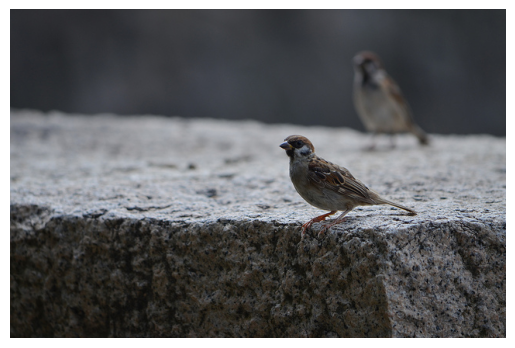

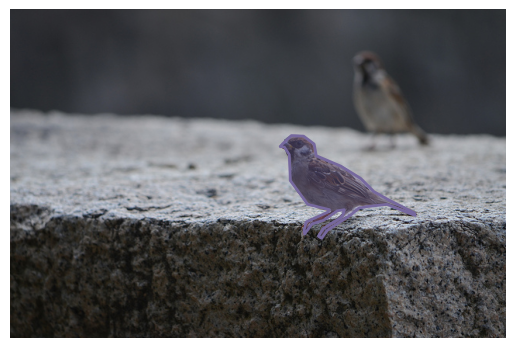

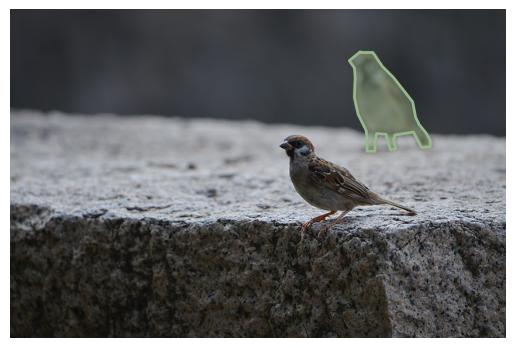

In [183]:
show_image(refcoco, 515054, None)

<class 'int'> 320045
refcoco: 

ref_id:  14898 , num_sentences:  4
sent_ids:  [23016, 23017]
ann_id:  384256
False the chair the cat is sitting on
False wooden chair in which cat is sitting
True (parent: 23016),  the throne the cat is sitting on
True (parent: 23017),  wooden chair in which cat is lounging


ref_id:  16282 , num_sentences:  4
sent_ids:  [26328, 26329]
ann_id:  1091778
False a small table with an empty drink cup and food basket sitting on it
False a table next to a chair with a cat on it
True (parent: 26328),  a small table with an empty drink cup and food basket sitting on it
True (parent: 26329),  a table next to a chair with a cat on it


ref_id:  16931 , num_sentences:  4
sent_ids:  [27874, 27875]
ann_id:  1091944
False a table with a cup of cola on it
False a blurry table with a cup of coffee on it
True (parent: 27874),  a table with a cup of potion on it
True (parent: 27875),  a blurry table with a cup of tea on it


ref_id:  21628 , num_sentences:  4
sent_ids:  [3

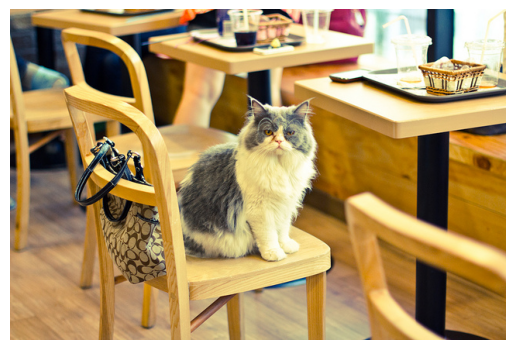

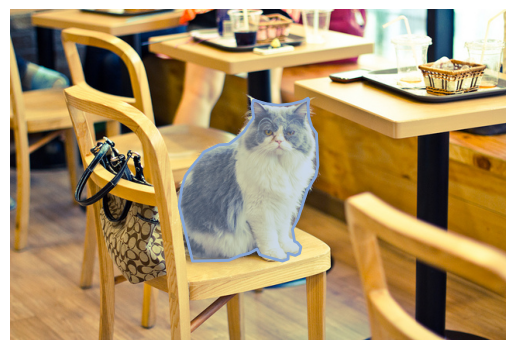

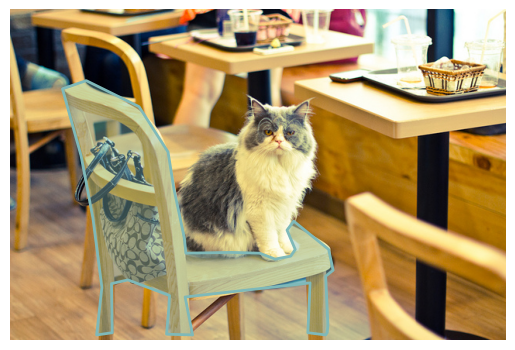

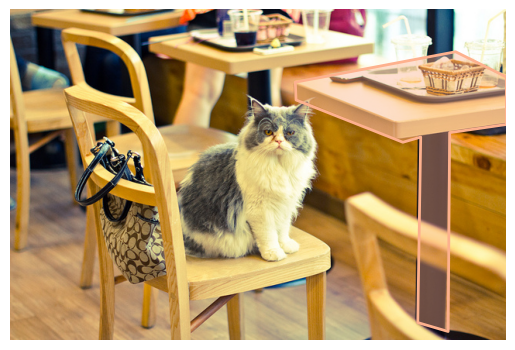

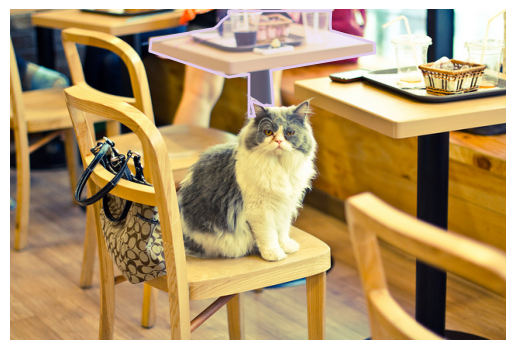

...

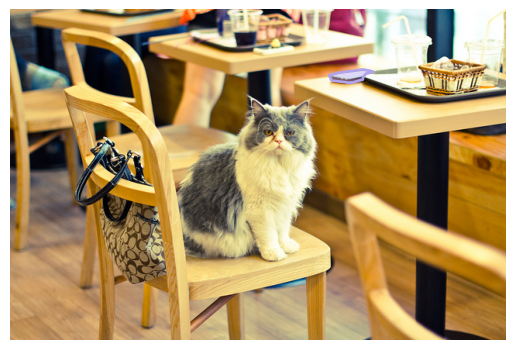

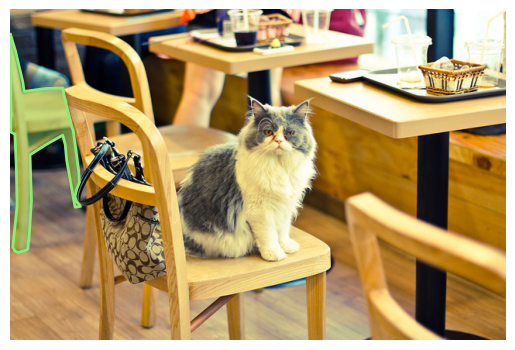

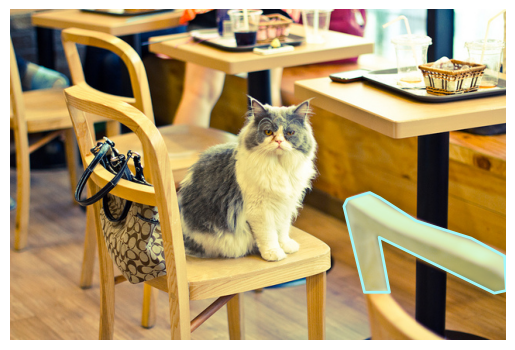

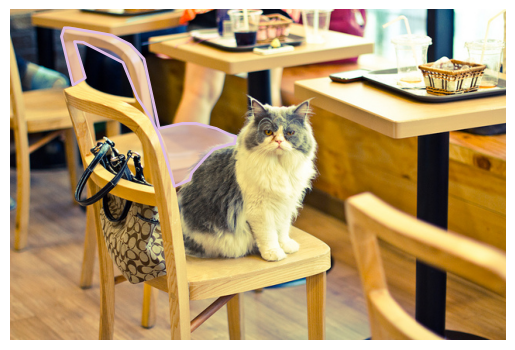

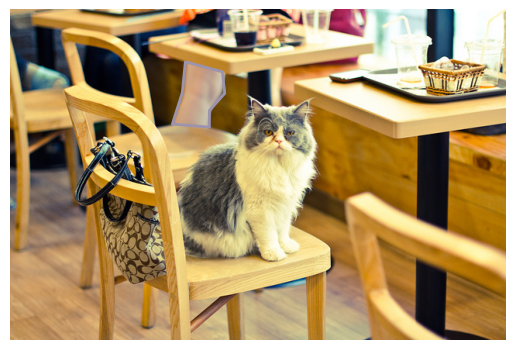

In [184]:
show_image(refcoco, 320045, None)

<class 'int'> 573314
refcoco: 

ref_id:  43208 , num_sentences:  4
sent_ids:  [89334, 89335]
ann_id:  176227
False a man standing in a white boat
False a white boat
True (parent: 89334),  a woman standing in a pink boat
True (parent: 89335),  a pink boat

robustref: 
Displaying image: {'license': 1, 'file_name': 'COCO_train2014_000000573314.jpg', 'coco_url': 'http://mscoco.org/images/573314', 'height': 427, 'width': 640, 'date_captured': '2013-11-17 13:06:05', 'flickr_url': 'http://farm3.staticflickr.com/2603/3982230660_5fc4403ec1_z.jpg', 'id': 573314}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000573314.jpg
Ann count:  5


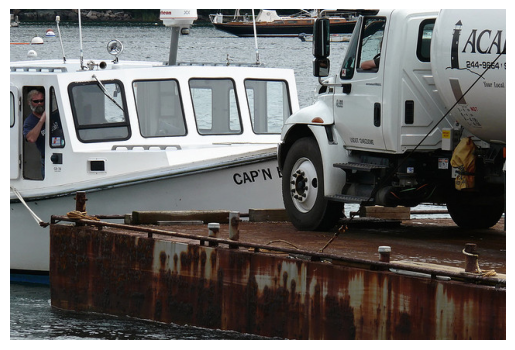

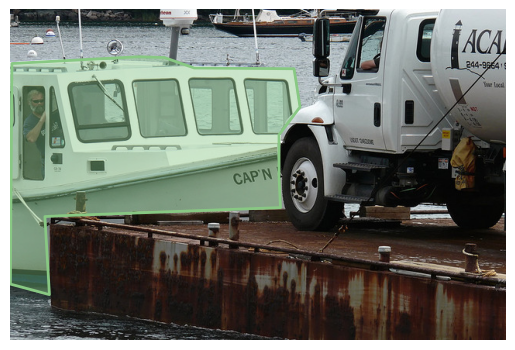

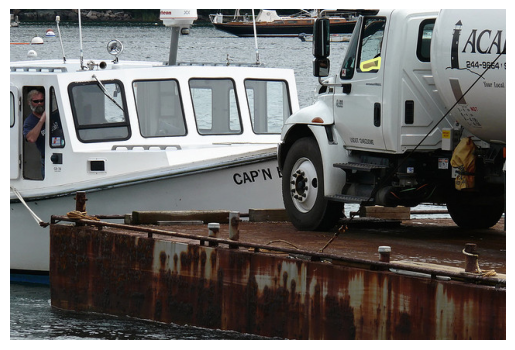

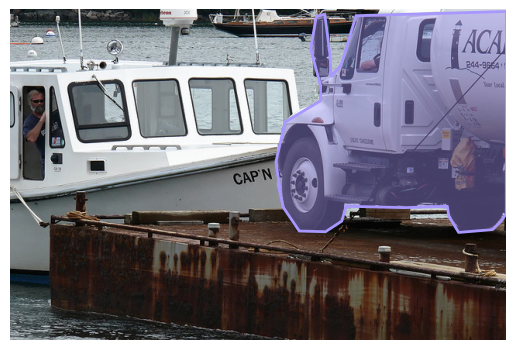

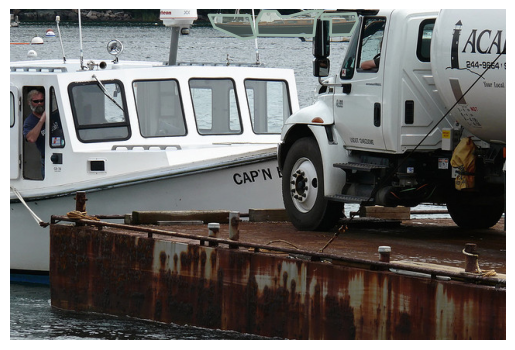

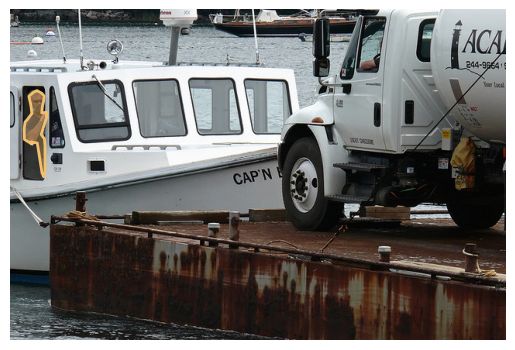

In [185]:
show_image(refcoco, 573314, None)

<class 'int'> 212095
refcoco: 

ref_id:  10644 , num_sentences:  4
sent_ids:  [13141, 13142]
ann_id:  422327
False a man on a surf board
False man in a black and blue wetsuit riding a surfboard
True (parent: 13141),  a lady on a surf board
True (parent: 13142),  woman in a black and pink wetsuit riding a surfboard

robustref: 
Displaying image: {'license': 1, 'file_name': 'COCO_train2014_000000212095.jpg', 'coco_url': 'http://mscoco.org/images/212095', 'height': 480, 'width': 640, 'date_captured': '2013-11-20 18:30:30', 'flickr_url': 'http://farm4.staticflickr.com/3160/2695963569_fb375d36ea_z.jpg', 'id': 212095}
Img path:  /shared/gbiamby/data/coco/train2014/COCO_train2014_000000212095.jpg
Ann count:  3


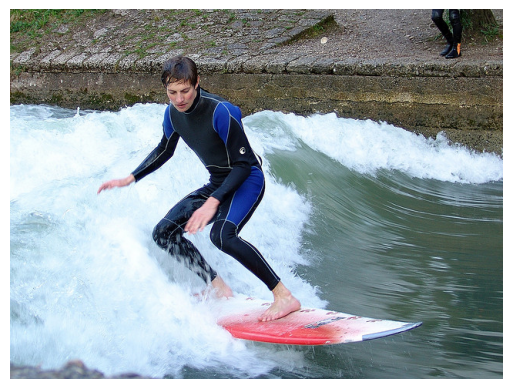

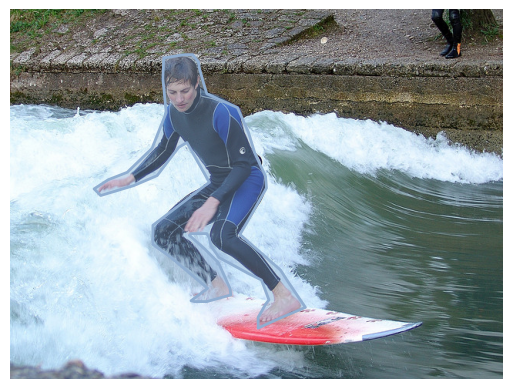

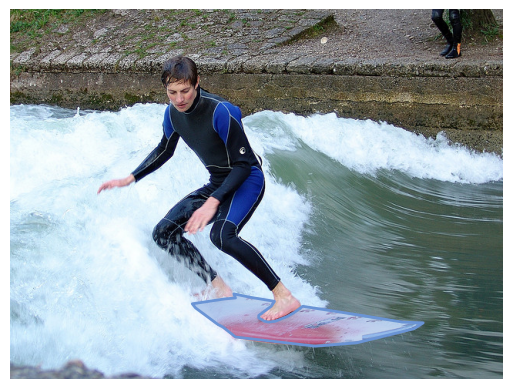

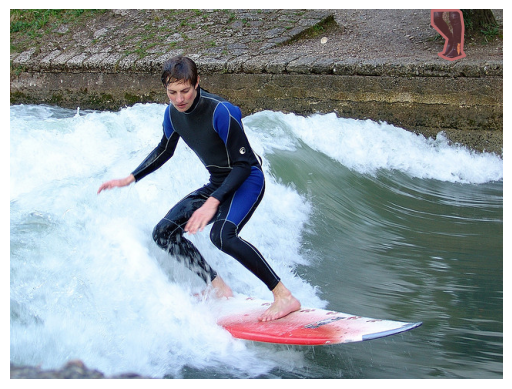

In [187]:
show_image(refcoco, 212095, None)

<class 'int'> 56359
refcoco: 

ref_id:  9442 , num_sentences:  3
sent_ids:  [10323, 10324]
ann_id:  581496
False an elephant walking calmly to the left of another elephant with it ' s mouth open
False elephant on left
True (parent: 10324),  giraffe on left


ref_id:  34950 , num_sentences:  4
sent_ids:  [70026, 70027]
ann_id:  583084
False an elephant with its trunk up
False an elephant with its trunk in the air
True (parent: 70026),  an elephant with its tail up
True (parent: 70027),  an elephant with its trunk in the sky


ref_id:  38244 , num_sentences:  4
sent_ids:  [77693, 77694]
ann_id:  459858
False a man in a green shirt to the right of another man in a green shirt
False the person on the elephant with its trunk up
True (parent: 77693),  a woman in a pink shirt to the right of another woman in a pink shirt
True (parent: 77694),  the person on the elephant with its trunk down

robustref: 

ref_id:  45090 , num_sentences:  6
sent_ids:  [128211, 128212, 128213]
ann_id:  583084
Fal

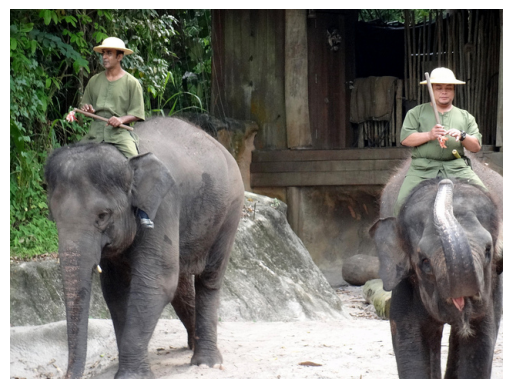

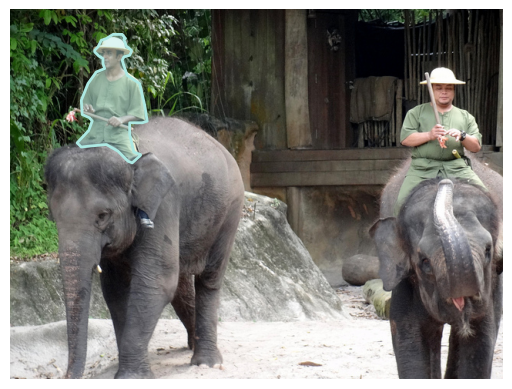

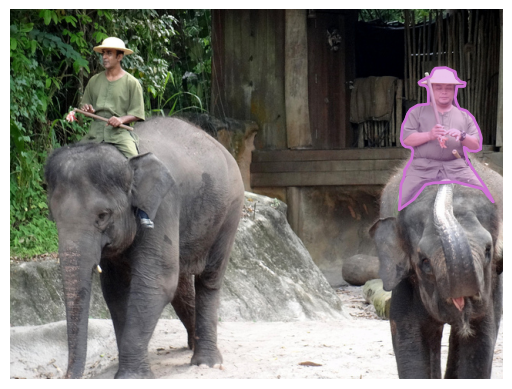

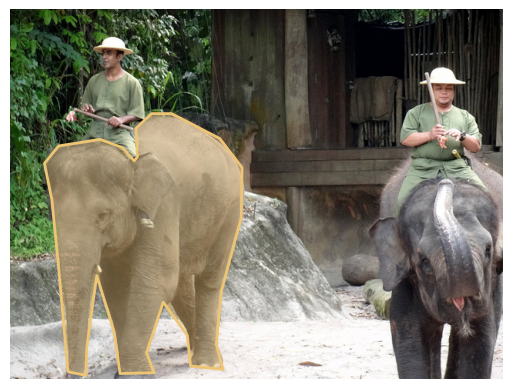

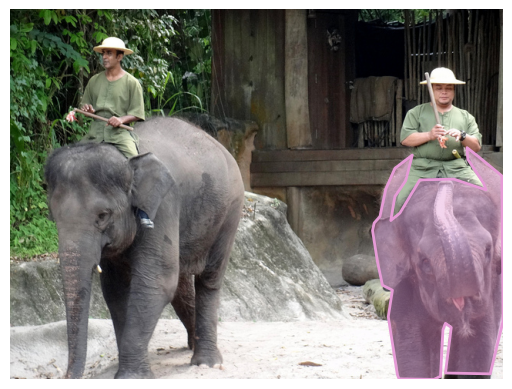

In [186]:
show_image(refcoco, 56359, None)

<class 'int'> 418500
refcoco: 

ref_id:  11327 , num_sentences:  4
sent_ids:  [14725, 14726]
ann_id:  2154264
False a statue on a bench is being sat next to by a man in shorts
False a statue of a man holding a dog
True (parent: 14725),  a painting on a bench is being sat next to by a woman in shorts
True (parent: 14726),  a painting of a woman holding a cat


ref_id:  36822 , num_sentences:  4
sent_ids:  [74445, 74446]
ann_id:  198685
False the man with no shirt
False middle aged white tourist sitting on a bench next to a statue of a black man who is holding a black and white puppy
True (parent: 74445),  the woman with no shoes
True (parent: 74446),  middle aged black tourist sitting on a bench next to a painting of a white woman who is holding a black and white kitten

robustref: 

ref_id:  14241 , num_sentences:  6
sent_ids:  [40528, 40529, 40530]
ann_id:  2154264
False wax figure
False black sculpture
False guy with dog
False cat on the left
False big elephant
False black teddy bear

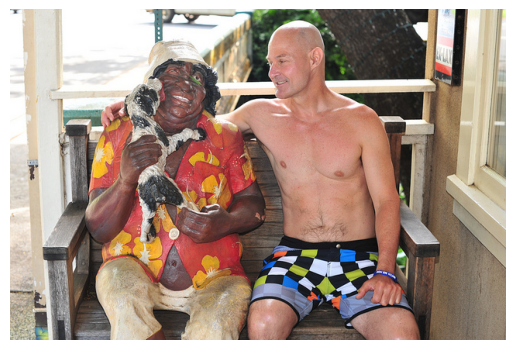

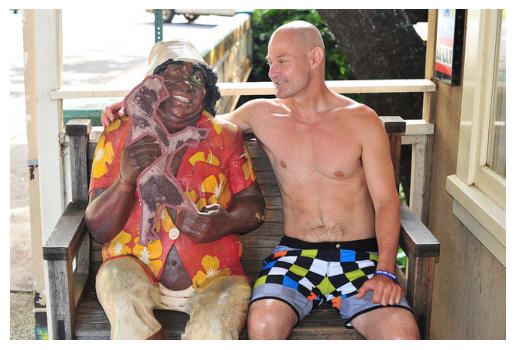

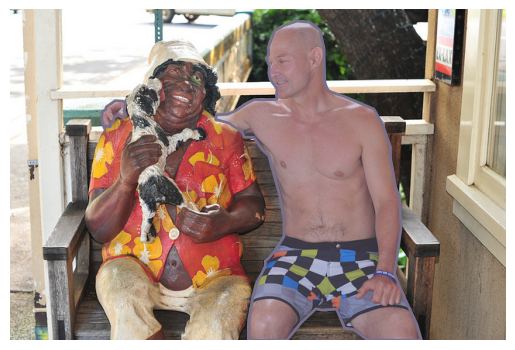

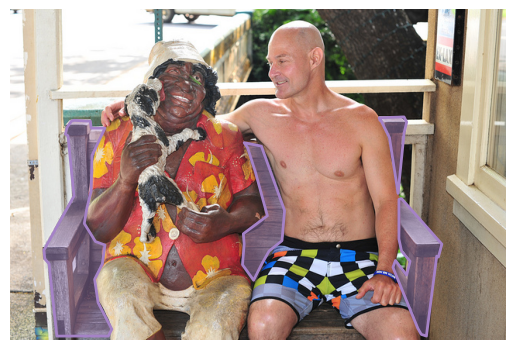

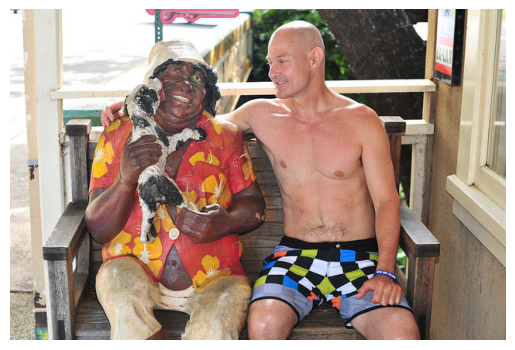

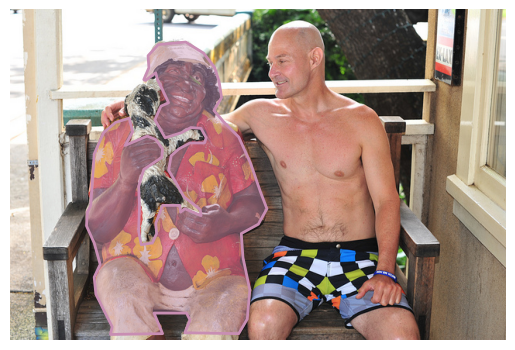

In [194]:
show_image(refcoco, 418500, None)